In [1]:
# !pip install ebooklib
# !pip install pypdfium2
# !pip install pdfkit

In [43]:
# import ebooklib
from ebooklib import epub
from pathlib import Path
from os import getcwd, environ
from sys import path

In [2]:
PROJ_DIR = Path(getcwd()).parent
DATA_DIR = PROJ_DIR / "data"

In [3]:
book_name = "Cosmere - Stormlight Archive - 1 - Way of Kings"
epub_file = DATA_DIR / (book_name + ".epub")
pdf_file = DATA_DIR  / (book_name +".pdf")

In [4]:
book = epub.read_epub(epub_file)

c:\Python312\Lib\site-packages\ebooklib\epub.py:1395: UserWarning: In the future version we will turn default option ignore_ncx to True.
  warnings.warn('In the future version we will turn default option ignore_ncx to True.')


# PDF conversion testing

In [ ]:
# import pypdfium2 as pdfium
import pdfkit

In [ ]:
def convert_epub_to_pdf(epub_path, pdf_path):
    book = epub.read_epub(epub_path)

    pdf_canvas = canvas.Canvas(pdf_path)
    
    for item in book.get_items():
        if isinstance(item, ebooklib.epub.EpubHtml):
            content = item.content
            # Process the content (e.g., convert HTML to text)
            pdf_canvas.drawString(100, 700, content)
    
    pdf_canvas.save()


In [9]:

# pdf = pdfium.PdfDocument.new()
pages = []
for i, item in enumerate(book.get_items_of_type(ebooklib.ITEM_DOCUMENT)):
    
    content = item.get_content()
    # renderer = pdfium.PdfPage(pdf)
    # renderer = pdf.new_page()
    pages.append(content.decode('utf-8'))
    if i == 10:
        break
# pdfkit.from_string(pages, pdf_file)

OSError: No wkhtmltopdf executable found: "b''"
If this file exists please check that this process can read it or you can pass path to it manually in method call, check README. Otherwise please install wkhtmltopdf - https://github.com/JazzCore/python-pdfkit/wiki/Installing-wkhtmltopdf

In [21]:
convert_epub_to_pdf(str(epub_file), str(pdf_file))

# Epub exploration

In [5]:
from ebooklib.utils import debug
from ebooklib import ITEM_DOCUMENT
from bs4 import BeautifulSoup

In [10]:
book.metadata

{'http://calibre.kovidgoyal.net/2009/metadata': {'timestamp': [(None,
    {'name': 'calibre:timestamp', 'content': '2018-12-14T22:02:37+00:00'})],
  'title_sort': [(None,
    {'name': 'calibre:title_sort',
     'content': 'Way of Kings (The Stormlight Archive, Book 1), The'})],
  'author_link_map': [(None,
    {'name': 'calibre:author_link_map',
     'content': '{"Brandon Sanderson": ""}'})]},
 'http://purl.org/dc/elements/1.1/': {'title': [('The Way of Kings (The Stormlight Archive, Book 1)',
    {})],
  'creator': [('Brandon Sanderson',
    {'{http://www.idpf.org/2007/opf}role': 'aut',
     '{http://www.idpf.org/2007/opf}file-as': 'Sanderson, Brandon'})],
  'identifier': [('12f4edfb-bce5-4761-9782-b441c2e5989e',
    {'id': 'uuid_id', '{http://www.idpf.org/2007/opf}scheme': 'uuid'}),
   ('12f4edfb-bce5-4761-9782-b441c2e5989e',
    {'{http://www.idpf.org/2007/opf}scheme': 'calibre'}),
   ('B003P2WO5E', {'{http://www.idpf.org/2007/opf}scheme': 'MOBI-ASIN'})],
  'contributor': [('calibre

In [11]:
book.toc[0]

In [12]:
docs = book.get_items_of_type(ITEM_DOCUMENT)
docs = [doc for doc in docs if doc.get_content()]

In [13]:
print(docs[7].get_body_content())

b'<body class="calibre">\n<p id="filepos11462" class="calibre_"><a/><a/><a/><img alt="" src="images/00008.jpg" class="calibre1"/></p><div class="calibre_1">\xc2\xa0</div>  <div class="mbp_pagebreak" id="calibre_pb_7"/>\n</body>\n'


In [14]:
len(docs) - 2

112

In [15]:
docs = list(book.get_items_of_type(ITEM_DOCUMENT))
toc = docs[112]
roshar_map = docs[7]
ch1 = docs[8]

In [16]:
print(ch1.is_chapter())
print(roshar_map.is_chapter())
print(toc.is_chapter())
ch1.get_name()
roshar_map.get_name()

True
True
True


'index_split_006.html'

In [17]:
soup = BeautifulSoup(toc.get_content().decode('utf-8'), 'html.parser')

In [18]:
for elem in soup.body.children:
    # if elem.name == 'h1':
    #     print(elem) # Returns only 'CONTENTS'
    if elem.name == 'p': # Parts, Interludes, and everything lse
        print(elem.text)
    elif elem.name == 'blockquote': # Chapters
        print(elem.text)

Title Page
Copyright Notice
Dedication
Acknowledgments
Prelude to the Stormlight Archive
Book One: The Way of Kings
Prologue: To Kill
Part One: Above Silence
1: STORMBLESSED
2: HONOR IS DEAD
3: CITY OF BELLS
4: THE SHATTERED PLAINS
5: HERETIC
6: BRIDGE FOUR
7: ANYTHING REASONABLE
8: NEARER THE FLAME
9: DAMNATION
10: STORIES OF SURGEONS
11: DROPLETS
Interludes
1-1: ISHIKK
1-2: NAN BALAT
1-3: THE GLORY OF IGNORANCE
Part Two: The Illuminating Storms
12: UNITY
13: TEN HEARTBEATS
14: PAYDAY
15: THE DECOY
16: COCOONS
17: A BLOODY, RED SUNSET
18: HIGHPRINCE OF WAR
19: STARFALLS
20: SCARLET
21: WHY MEN LIE
22: EYES, HANDS, OR SPHERES?
23: MANY USES
24: THE GALLERY OF MAPS
25: THE BUTCHER
26: STILLNESS
27: CHASM DUTY
28: DECISION
Interludes
1-4: RYSN
1-5: AXIES THE COLLECTOR
1-6: A WORK OF ART
Part Three: Dying
29: ERRORGANCE
30: DARKNESS UNSEEN
31: BENEATH THE SKIN
32: SIDE CARRY
33: CYMATICS
34: STORMWALL
35: A LIGHT BY WHICH TO SEE
36: THE LESSON
37: SIDES
38: ENVISAGER
39: BURNED INTO HER
4

In [6]:

def extract_chapters_and_interludes(epub_path):
    """
    Extracts chapters and interludes from an EPUB file based on the updated TOC structure.

    Args:
        epub_path (str): The path to the EPUB file.

    Returns:
        A dictionary representing the book's structure:
        {
            'parts': [
                {
                    'title': 'Part Title',
                    'chapters': [
                        {'title': 'Chapter Title', 'content': 'Plain text content'},
                        ...
                    ],
                    'interludes': [
                        {
                            'title': 'Interlude Section Title',
                            'chapters': [
                                {'title': 'Interlude Chapter Title', 'content': 'Plain text content'},
                                ...
                            ]
                        },
                        ...
                    ]
                },
                ...
            ]
        }
    """
        
    items = list(book.get_items())  # Get all items, including HTML fragments

    book_structure = {'parts': []}
    current_part = None
    current_interlude = None

    # Find the TOC item
    toc_item = next((item for item in items if item.get_id() == 'id121'), None)

    if not toc_item:
        raise ValueError("Table of Contents not found in the EPUB file.")

    toc_html = toc_item.get_content().decode('utf-8')
    soup = BeautifulSoup(toc_html, 'html.parser')

    # Iterate through TOC elements, skipping the first `<h1>` ('CONTENTS')
    for elem in soup.body.children:
        if elem.name == 'p': 
            text = elem.text.strip()
            if text == 'Ars Arcanum': break
            if 'part' in text.lower():
                current_part = {'title': text, 'chapters': [], 'interludes': []}
                book_structure['parts'].append(current_part)
                current_interlude = None 

            elif 'interlude' in text.lower() and current_part:
                current_interlude = {'title': text, 'chapters': []}
                current_part['interludes'].append(current_interlude)

            elif any(substring in text.lower() for substring in ['prelude', 'prologue', 'epilogue', 'endnote']):
                    
                for link in elem.find_all('a'):
                    # print(link)
                    # chapter_title = link.text.strip()
                    chapter_href = link['href']
                    # print(chapter_href)

                    # Find the corresponding chapter item, handling both EpubHtml and EpubItem types
                    chapter_item = next(
                        (i for i in items if isinstance(i, epub.EpubHtml) and i.file_name == chapter_href.split("#")[0]
                        ), None
                    )

                    if chapter_item:
                        chapter_content = chapter_item.get_content().decode('utf-8')
                        chapter_soup = BeautifulSoup(chapter_content, 'html.parser')
                        plain_text = chapter_soup.text.strip()
                        # print(plain_text)
                        book_structure['parts'].append({'title': text, 'content': plain_text})
        elif elem.name == 'blockquote': # Chapters
            for link in elem.find_all('a'):
                # print(link)
                chapter_title = link.text.strip()
                chapter_href = link['href']
                # print(chapter_href)

                # Find the corresponding chapter item, handling both EpubHtml and EpubItem types
                chapter_item = next(
                    (i for i in items if isinstance(i, epub.EpubHtml) and i.file_name == chapter_href.split("#")[0]
                    ), None
                )

                if chapter_item:
                    chapter_content = chapter_item.get_content().decode('utf-8')
                    chapter_soup = BeautifulSoup(chapter_content, 'html.parser')
                    plain_text = chapter_soup.text.strip()
                    chapter_data = {'title': chapter_title, 'content': plain_text}
                    if current_interlude:
                        current_interlude['chapters'].append(chapter_data)
                    else:
                        current_part['chapters'].append(chapter_data)
    return book_structure

In [20]:
book_structure = extract_chapters_and_interludes(epub_file)

In [21]:
book_structure

{'parts': [{'title': 'Prelude to the Stormlight Archive',
   'content': 'PRELUDE TOTHE STORMLIGHT ARCHIVE\xa0\nKalak rounded a rocky stone ridge and stumbled to a stop before the body of a dying thunderclast. The enormous stone beast lay on its side, riblike protrusions from its chest broken and cracked. The monstrosity was vaguely skeletal in shape, with unnaturally long limbs that sprouted from granite shoulders. The eyes were deep red spots on the arrowhead face, as if created by a fire burning deep within the stone. They faded.\nEven after all these centuries, seeing a thunderclast up close made Kalak shiver. The beast’s hand was as long as a man was tall. He’d been killed by hands like those before, and it hadn’t been pleasant.\nOf course, dying rarely was.\nHe rounded the creature, picking his way more carefully across the battlefield. The plain was a place of misshapen rock and stone, natural pillars rising around him, bodies littering the ground. Few plants lived here.\nThe sto

In [22]:
texts = []
for part in book_structure['parts']:
    if 'content' in part.keys():
        texts.append({'title': part['title'], 'len': len(part['content'].split())})
    elif 'chapters' in part.keys():
        for chapter in part['chapters']:
            texts.append({'title': chapter['title'], 'len': len(chapter['content'].split())})

In [23]:
import pandas as pd
df = pd.DataFrame.from_dict(texts)
total = df['len'].sum()
avg = total/len(df)
print(f"Total paragraphs: {len(df)}")
print(f"Total words: {total}")
print(f"Average number of words: {round(avg, 2)}")

Total paragraphs: 79
Total words: 362095
Average number of words: 4583.48


C:\Users\Izogie\AppData\Local\Temp\ipykernel_18624\3376587390.py:1: DeprecationWarning: 
Pyarrow will become a required dependency of pandas in the next major release of pandas (pandas 3.0),
(to allow more performant data types, such as the Arrow string type, and better interoperability with other libraries)
but was not found to be installed on your system.
If this would cause problems for you,
please provide us feedback at https://github.com/pandas-dev/pandas/issues/54466
        
  import pandas as pd


# Ingest prose
- Chunking
    - Load semantic chunker
    - chunk paragraphs
- Vectorizing and storing
    - Pull [Chapter summaries](https://coppermind.net/wiki/Summary:The_Way_of_Kings)
    - Split summaries
    - Associate with 
    - Load SourceManager
    - Load Persistent DB

## Chunking 

In [9]:
# import SemanticChunker
from langchain_experimental.text_splitter import SemanticChunker
from langchain_huggingface import HuggingFaceEmbeddings

In [25]:
splitter = SemanticChunker(HuggingFaceEmbeddings())

c:\Python312\Lib\site-packages\huggingface_hub\file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [156]:
_ = book_structure['parts'][1]['content']
percent = [99, 98, 97, 96]
chunks = []
for p in percent:
    _splitter = SemanticChunker(HuggingFaceEmbeddings(),breakpoint_threshold_amount=p)
    print(p)
    chunks.append(_splitter.split_text(_)[:3])

c:\Python312\Lib\site-packages\huggingface_hub\file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


99
98
97
96


In [157]:
for chunk in chunks:
    for split in chunk:
        print(split)
        print("-")
    print("\n --- \n")

“The love of men is a frigid thing, a mountain stream only three steps from the ice. We are his. Oh Stormfather … we are his. It is but a thousand days, and the Everstorm comes.”
—Collected on the first day of the week Palah of the month Shash of the year 1171, thirty-one seconds before death. Subject was a darkeyed pregnant woman of middle years.
-
The child did not survive. Szeth-son-son-Vallano, Truthless of Shinovar, wore white on the day he was to kill a king. The white clothing was a Parshendi tradition, foreign to him. But he did as his masters required and did not ask for an explanation. He sat in a large stone room, baked by enormous firepits that cast a garish light upon the revelers, causing beads of sweat to form on their skin as they danced, and drank, and yelled, and sang, and clapped. Some fell to the ground red-faced, the revelry too much for them, their stomachs proving to be inferior wineskins. They looked as if they were dead, at least until their friends carried the

### Test chunking

In [31]:
"""Experimental **text splitter** based on semantic similarity."""

import copy
import re
from typing import Any, Dict, Iterable, List, Literal, Optional, Sequence, Tuple, cast
import matplotlib.pyplot as plt

import numpy as np
from langchain_community.utils.math import (
    cosine_similarity,
)
from langchain_core.documents import BaseDocumentTransformer, Document
from langchain_core.embeddings import Embeddings


def combine_sentences(sentences: List[dict], buffer_size: int = 1) -> List[dict]:
    """Combine sentences based on buffer size.

    Args:
        sentences: List of sentences to combine.
        buffer_size: Number of sentences to combine. Defaults to 1.

    Returns:
        List of sentences with combined sentences.
    """

    # Go through each sentence dict
    for i in range(len(sentences)):
        # Create a string that will hold the sentences which are joined
        combined_sentence = ""

        # Add sentences before the current one, based on the buffer size.
        for j in range(i - buffer_size, i):
            # Check if the index j is not negative
            # (to avoid index out of range like on the first one)
            if j >= 0:
                # Add the sentence at index j to the combined_sentence string
                combined_sentence += sentences[j]["sentence"] + " "

        # Add the current sentence
        combined_sentence += sentences[i]["sentence"]

        # Add sentences after the current one, based on the buffer size
        for j in range(i + 1, i + 1 + buffer_size):
            # Check if the index j is within the range of the sentences list
            if j < len(sentences):
                # Add the sentence at index j to the combined_sentence string
                combined_sentence += " " + sentences[j]["sentence"]

        # Then add the whole thing to your dict
        # Store the combined sentence in the current sentence dict
        sentences[i]["combined_sentence"] = combined_sentence

    return sentences


def calculate_cosine_distances(sentences: List[dict]) -> Tuple[List[float], List[dict]]:
    """Calculate cosine distances between sentences.

    Args:
        sentences: List of sentences to calculate distances for.

    Returns:
        Tuple of distances and sentences.
    """
    distances = []
    for i in range(len(sentences) - 1):
        embedding_current = sentences[i]["combined_sentence_embedding"]
        embedding_next = sentences[i + 1]["combined_sentence_embedding"]

        # Calculate cosine similarity
        similarity = cosine_similarity([embedding_current], [embedding_next])[0][0]

        # Convert to cosine distance
        distance = 1 - similarity

        # Append cosine distance to the list
        distances.append(distance)

        # Store distance in the dictionary
        sentences[i]["distance_to_next"] = distance

    # Optionally handle the last sentence
    # sentences[-1]['distance_to_next'] = None  # or a default value

    return distances, sentences


BreakpointThresholdType = Literal[
    "percentile", "standard_deviation", "interquartile", "gradient"
]
BREAKPOINT_DEFAULTS: Dict[BreakpointThresholdType, float] = {
    "percentile": 95,
    "standard_deviation": 3,
    "interquartile": 1.5,
    "gradient": 95,
}


class SemanticChunker(BaseDocumentTransformer):
    """Split the text based on semantic similarity.

    Taken from Greg Kamradt's wonderful notebook:
    https://github.com/FullStackRetrieval-com/RetrievalTutorials/blob/main/tutorials/LevelsOfTextSplitting/5_Levels_Of_Text_Splitting.ipynb

    All credits to him.

    At a high level, this splits into sentences, then groups into groups of 3
    sentences, and then merges one that are similar in the embedding space.
    """

    def __init__(
        self,
        embeddings: Embeddings,
        buffer_size: int = 1,
        add_start_index: bool = False,
        breakpoint_threshold_type: BreakpointThresholdType = "percentile",
        breakpoint_threshold_amount: Optional[float] = None,
        number_of_chunks: Optional[int] = None,
        sentence_split_regex: str = r"(?<=[.?!])\s+",
    ):
        self._add_start_index = add_start_index
        self.embeddings = embeddings
        self.buffer_size = buffer_size
        self.breakpoint_threshold_type = breakpoint_threshold_type
        self.number_of_chunks = number_of_chunks
        self.sentence_split_regex = sentence_split_regex
        if breakpoint_threshold_amount is None:
            self.breakpoint_threshold_amount = BREAKPOINT_DEFAULTS[
                breakpoint_threshold_type
            ]
        else:
            self.breakpoint_threshold_amount = breakpoint_threshold_amount

    def _calculate_breakpoint_threshold(
        self, distances: List[float]
    ) -> Tuple[float, List[float]]:
        if self.breakpoint_threshold_type == "percentile":
            return cast(
                float,
                np.percentile(distances, self.breakpoint_threshold_amount),
            ), distances
        elif self.breakpoint_threshold_type == "standard_deviation":
            return cast(
                float,
                np.mean(distances)
                + self.breakpoint_threshold_amount * np.std(distances),
            ), distances
        elif self.breakpoint_threshold_type == "interquartile":
            q1, q3 = np.percentile(distances, [25, 75])
            iqr = q3 - q1

            return np.mean(
                distances
            ) + self.breakpoint_threshold_amount * iqr, distances
        elif self.breakpoint_threshold_type == "gradient":
            # Calculate the threshold based on the distribution of gradient of distance array. # noqa: E501
            distance_gradient = np.gradient(distances, range(0, len(distances)))
            return cast(
                float,
                np.percentile(distance_gradient, self.breakpoint_threshold_amount),
            ), distance_gradient
        else:
            raise ValueError(
                f"Got unexpected `breakpoint_threshold_type`: "
                f"{self.breakpoint_threshold_type}"
            )

    def _threshold_from_clusters(self, distances: List[float]) -> float:
        """
        Calculate the threshold based on the number of chunks.
        Inverse of percentile method.
        """
        if self.number_of_chunks is None:
            raise ValueError(
                "This should never be called if `number_of_chunks` is None."
            )
        x1, y1 = len(distances), 0.0
        x2, y2 = 1.0, 100.0

        x = max(min(self.number_of_chunks, x1), x2)

        # Linear interpolation formula
        y = y1 + ((y2 - y1) / (x2 - x1)) * (x - x1)
        y = min(max(y, 0), 100)

        return cast(float, np.percentile(distances, y))

    def _calculate_sentence_distances(
        self, single_sentences_list: List[str]
    ) -> Tuple[List[float], List[dict]]:
        """Split text into multiple components."""

        _sentences = [
            {"sentence": x, "index": i} for i, x in enumerate(single_sentences_list)
        ]
        sentences = combine_sentences(_sentences, self.buffer_size)
        embeddings = self.embeddings.embed_documents(
            [x["combined_sentence"] for x in sentences]
        )
        for i, sentence in enumerate(sentences):
            sentence["combined_sentence_embedding"] = embeddings[i]

        return calculate_cosine_distances(sentences)

    def _display_distances(self, distances: List[float]) -> None:
        plt.plot(distances);

        y_upper_bound = .6
        plt.ylim(0, y_upper_bound)
        plt.xlim(0, len(distances))

        # We need to get the distance threshold that we'll consider an outlier
        # We'll use numpy .percentile() for this
        # breakpoint_percentile_threshold = 95
        # breakpoint_distance_threshold = np.percentile(distances, breakpoint_percentile_threshold) # If you want more chunks, lower the percentile cutoff
        (
            breakpoint_distance_threshold,
            breakpoint_array,
        ) = self._calculate_breakpoint_threshold(distances)
        plt.axhline(y=breakpoint_distance_threshold, color='r', linestyle='-');

        # Then we'll see how many distances are actually above this one
        num_distances_above_theshold = len([x for x in distances if x > breakpoint_distance_threshold]) # The amount of distances above your threshold
        plt.text(x=(len(distances)*.01), y=y_upper_bound/50, s=f"{num_distances_above_theshold + 1} Chunks");

        # Then we'll get the index of the distances that are above the threshold. This will tell us where we should split our text
        indices_above_thresh = [i for i, x in enumerate(distances) if x > breakpoint_distance_threshold] # The indices of those breakpoints on your list

        # Start of the shading and text
        colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k']
        for i, breakpoint_index in enumerate(indices_above_thresh):
            start_index = 0 if i == 0 else indices_above_thresh[i - 1]
            end_index = breakpoint_index if i < len(indices_above_thresh) - 1 else len(distances)

            plt.axvspan(start_index, end_index, facecolor=colors[i % len(colors)], alpha=0.25)
            plt.text(x=np.average([start_index, end_index]),
                    y=breakpoint_distance_threshold + (y_upper_bound)/ 20,
                    s=f"Chunk #{i}", horizontalalignment='center',
                    rotation='vertical')

        # # Additional step to shade from the last breakpoint to the end of the dataset
        if indices_above_thresh:
            last_breakpoint = indices_above_thresh[-1]
            if last_breakpoint < len(distances):
                plt.axvspan(last_breakpoint, len(distances), facecolor=colors[len(indices_above_thresh) % len(colors)], alpha=0.25)
                plt.text(x=np.average([last_breakpoint, len(distances)]),
                        y=breakpoint_distance_threshold + (y_upper_bound)/ 20,
                        s=f"Chunk #{i+1}",
                        rotation='vertical')

        plt.title("PG Essay Chunks Based On Embedding Breakpoints")
        plt.xlabel("Index of sentences in essay (Sentence Position)")
        plt.ylabel("Cosine distance between sequential sentences")
        plt.show()

    def split_text(
        self,
        text: str,
    ) -> List[str]:
        # Splitting the essay (by default on '.', '?', and '!')
        single_sentences_list = re.split(self.sentence_split_regex, text)

        # having len(single_sentences_list) == 1 would cause the following
        # np.percentile to fail.
        if len(single_sentences_list) == 1:
            return single_sentences_list
        distances, sentences = self._calculate_sentence_distances(single_sentences_list)
        if self.number_of_chunks is not None:
            breakpoint_distance_threshold = self._threshold_from_clusters(distances)
            breakpoint_array = distances
        else:
            (
                breakpoint_distance_threshold,
                breakpoint_array,
            ) = self._calculate_breakpoint_threshold(distances)
        self._display_distances(distances)
        indices_above_thresh = [
            i
            for i, x in enumerate(breakpoint_array)
            if x > breakpoint_distance_threshold
        ]
        # print(breakpoint_array)
        chunks = []
        start_index = 0

        # Iterate through the breakpoints to slice the sentences
        for index in indices_above_thresh:
            # The end index is the current breakpoint
            end_index = index

            # Slice the sentence_dicts from the current start index to the end index
            group = sentences[start_index : end_index + 1]
            combined_text = " ".join([d["sentence"] for d in group])
            # print(combined_text)
            chunks.append(combined_text)

            # Update the start index for the next group
            start_index = index + 1

        # The last group, if any sentences remain
        if start_index < len(sentences):
            combined_text = " ".join([d["sentence"] for d in sentences[start_index:]])
            # print("start index <", len(sentences), combined_text)
            chunks.append(combined_text)
        return chunks

    def create_documents(
        self, texts: List[str], metadatas: Optional[List[dict]] = None
    ) -> List[Document]:
        """Create documents from a list of texts."""
        _metadatas = metadatas or [{}] * len(texts)
        documents = []
        for i, text in enumerate(texts):
            index = -1
            for chunk in self.split_text(text):
                metadata = copy.deepcopy(_metadatas[i])
                if self._add_start_index:
                    index = text.find(chunk, index + 1)
                    metadata["start_index"] = index
                new_doc = Document(page_content=chunk, metadata=metadata)
                documents.append(new_doc)
        return documents

    def split_documents(self, documents: Iterable[Document]) -> List[Document]:
        """Split documents."""
        texts, metadatas = [], []
        for doc in documents:
            texts.append(doc.page_content)
            metadatas.append(doc.metadata)
        return self.create_documents(texts, metadatas=metadatas)

    def transform_documents(
        self, documents: Sequence[Document], **kwargs: Any
    ) -> Sequence[Document]:
        """Transform sequence of documents by splitting them."""
        return self.split_documents(list(documents))


In [20]:
# read plaintext dictionary from 'book_structure.txt'
with open('book_structure.txt') as f:
    book_structure = eval(f.read())

c:\Python312\Lib\site-packages\huggingface_hub\file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


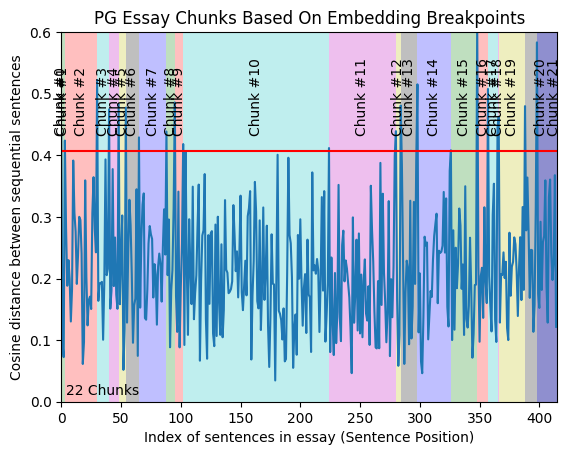

chunked len:  4554 original len:  4554


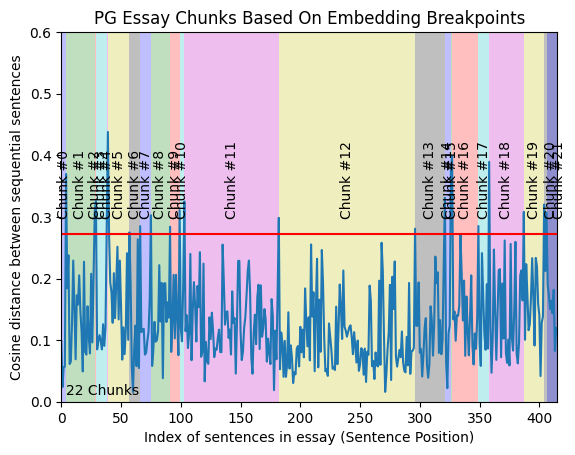

chunked len:  4554 original len:  4554


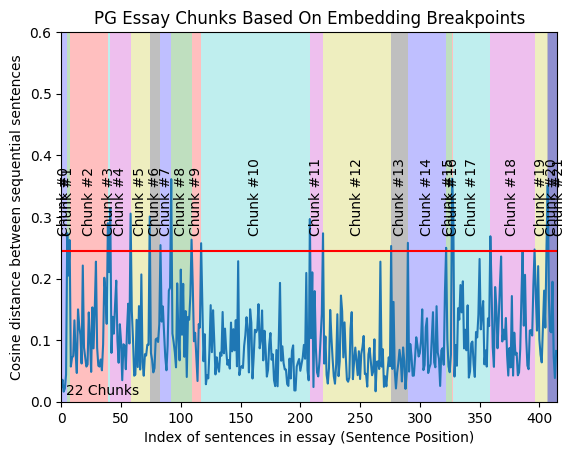

chunked len:  4554 original len:  4554


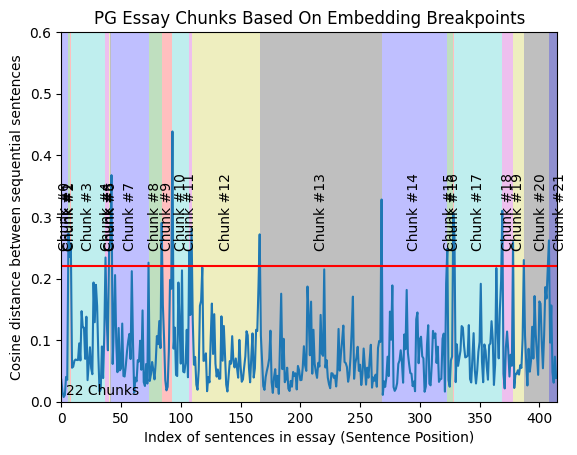

chunked len:  4554 original len:  4554


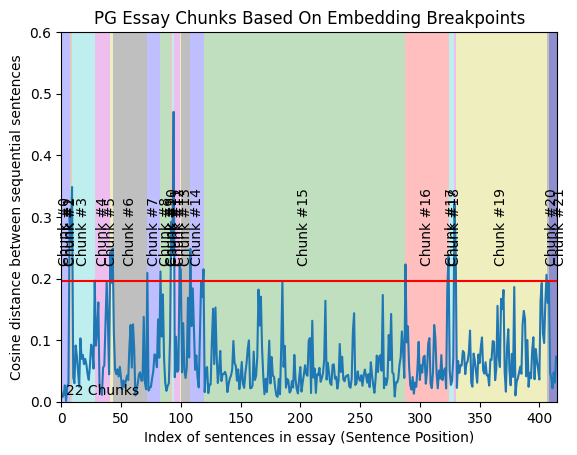

chunked len:  4554 original len:  4554


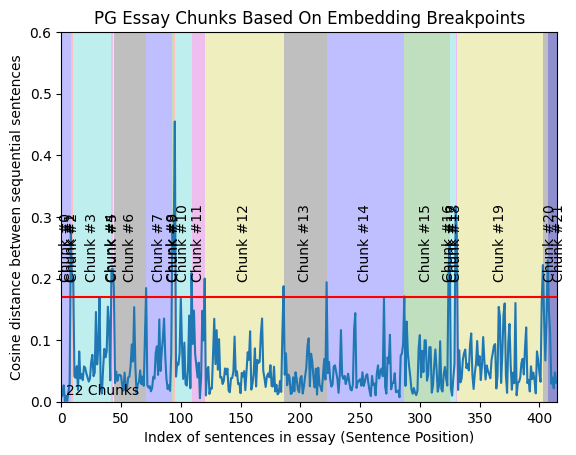

chunked len:  4554 original len:  4554


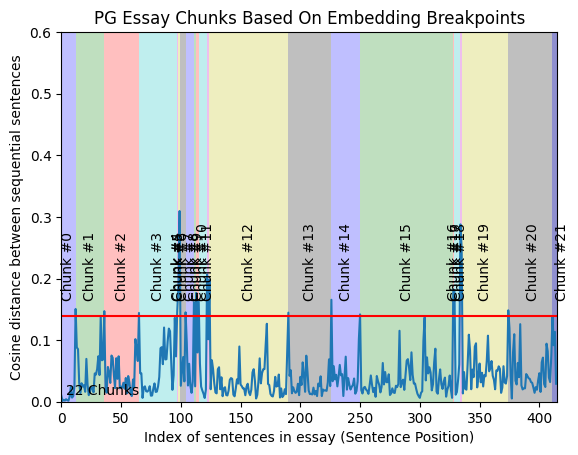

chunked len:  4554 original len:  4554


In [67]:
text =book_structure['parts'][2]['chapters'][0]['content']
for b in [1,2,3,4,5,6,10]:
    splitter = SemanticChunker(HuggingFaceEmbeddings(), breakpoint_threshold_amount=95, buffer_size=b)
    _ = splitter.split_text(text)
    print("chunked len: ", len(" ".join(_).split()), "original len: ", len(text.split()))
# print(_[10])

In [78]:
print(_[0])

“You’ve killed me. Bastards, you’ve killed me! While the sun is still hot, I die!”
—Collected on the fifth day of the week Chach of the month Betab of the year 1171, ten seconds before death. Subject was a darkeyed soldier thirty-one years of age. Sample is considered questionable. FIVE YEARS LATER 
I’m going to die, aren’t I?” Cenn asked. The weathered veteran beside Cenn turned and inspected him. The veteran wore a full beard, cut short. At the sides, the black hairs were starting to give way to grey. I’m going to die, Cenn thought, clutching his spear—the shaft slick with sweat. I’m going to die. Oh, Stormfather. I’m going to die.


percentile 95


c:\Python312\Lib\site-packages\huggingface_hub\file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


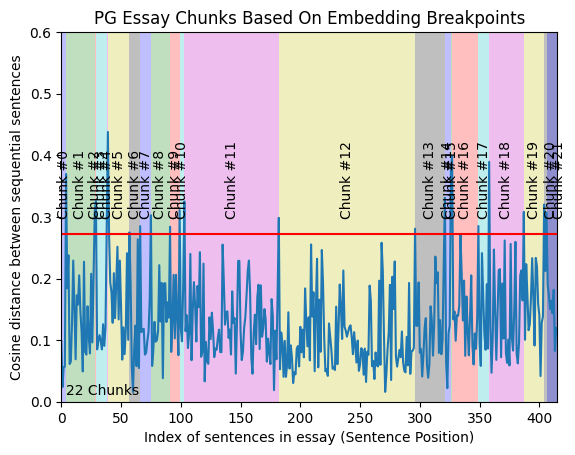

standard_deviation 1


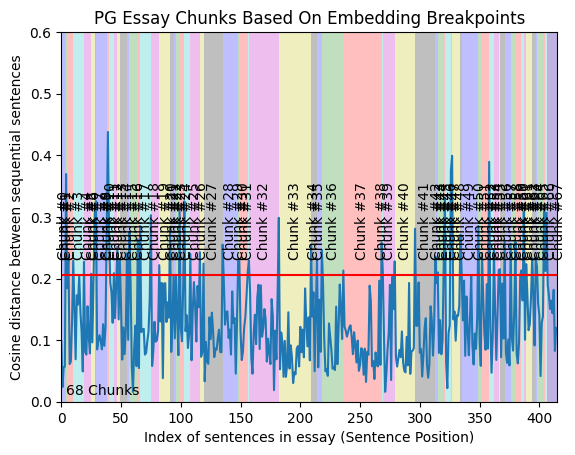

standard_deviation 2


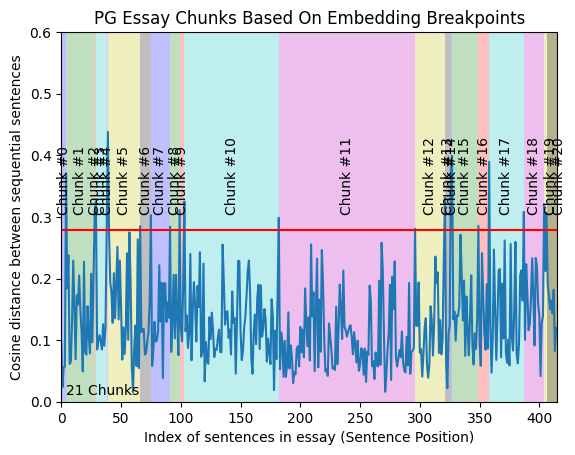

standard_deviation 3


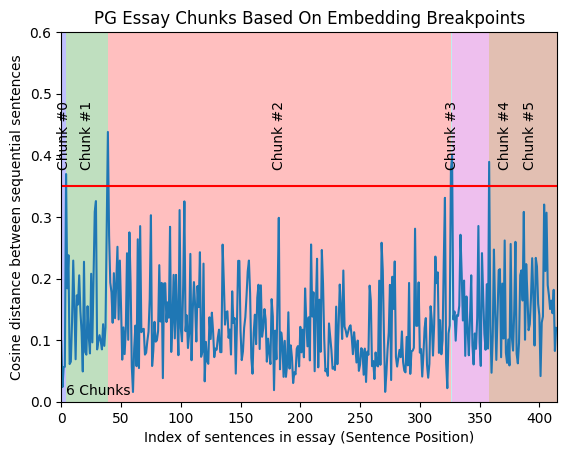

interquartile 1.5


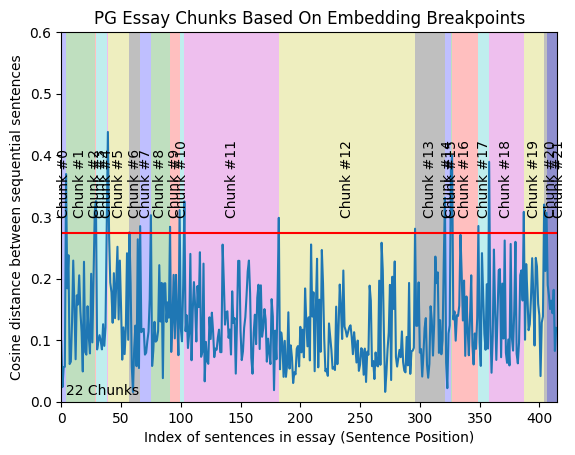

interquartile 1.6


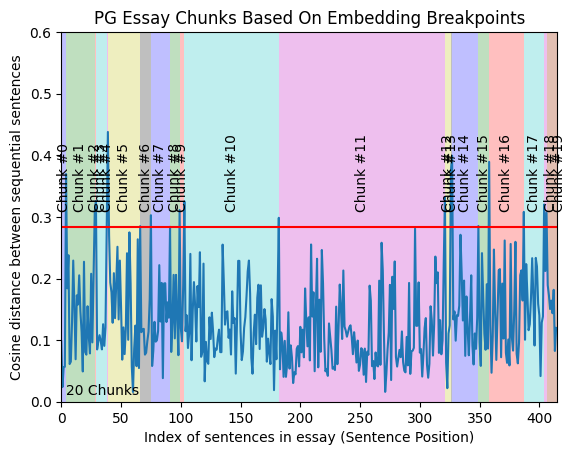

interquartile 1.7


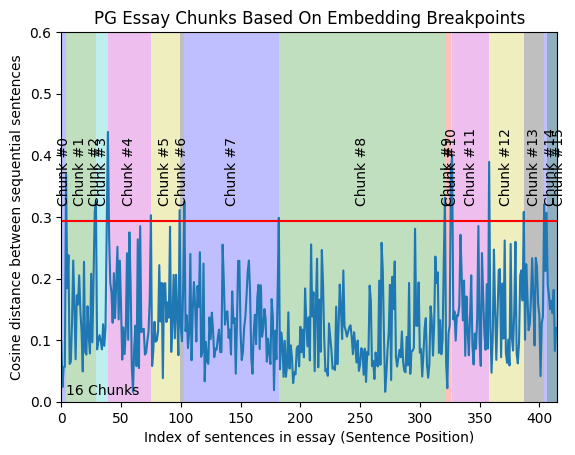

interquartile 1.8


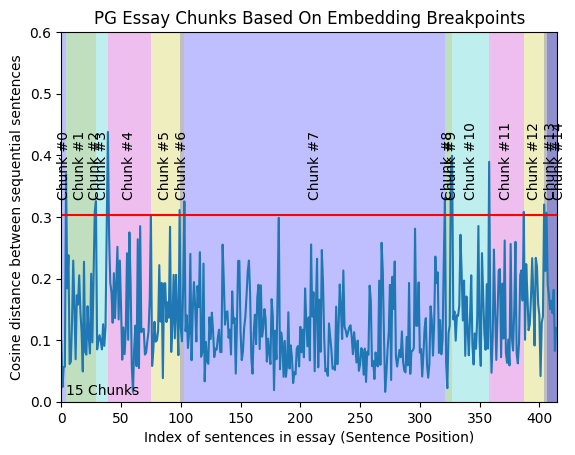

interquartile 1.4


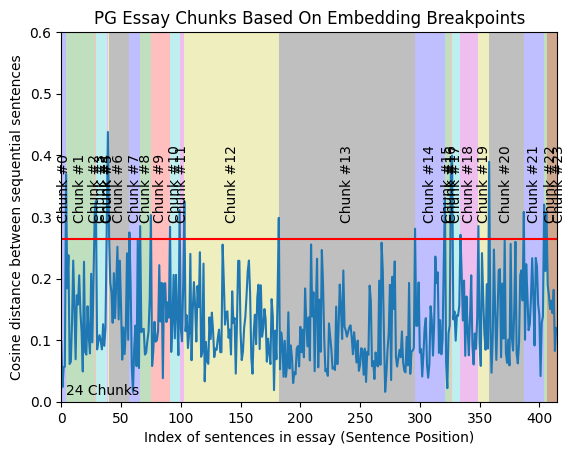

gradient 98


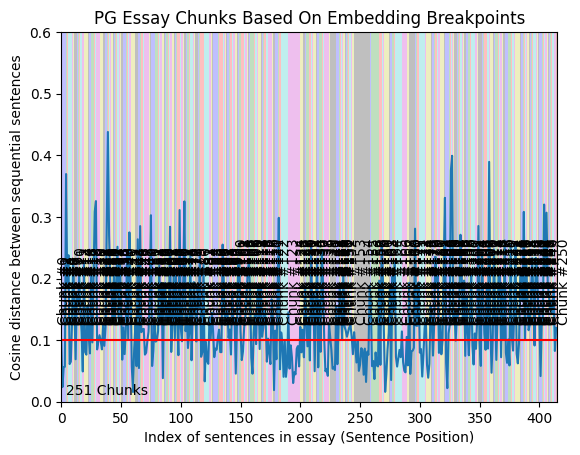

gradient 99


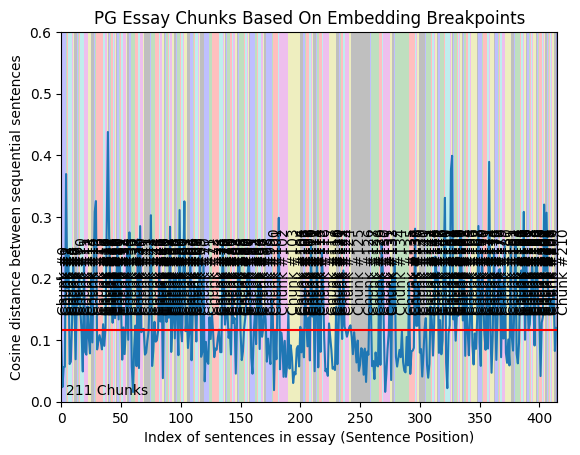

gradient 100


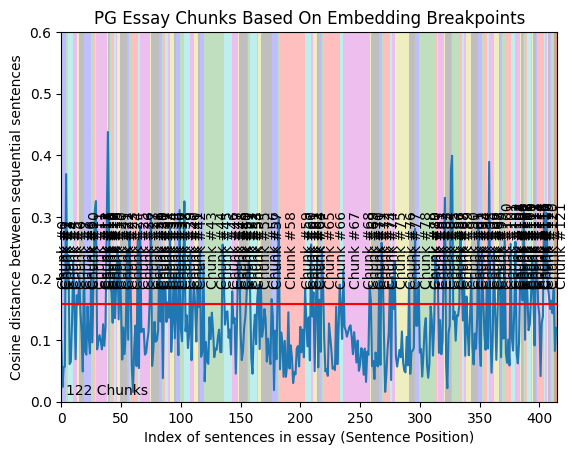

gradient 105


ValueError: Percentiles must be in the range [0, 100]

In [82]:
types = {"percentile": [95],"standard_deviation": [1,2,3], "interquartile":[1.5, 1.6, 1.7, 1.8, 1.4],"gradient":[98,  99, 100]}

text =book_structure['parts'][2]['chapters'][0]['content']
for t in types.keys():
    for v in types[t]:
        print(t, v)
        splitter = SemanticChunker(HuggingFaceEmbeddings(), breakpoint_threshold_type=t, breakpoint_threshold_amount=v, buffer_size=2)
        _ = splitter.split_text(text)
    # print("chunked len: ", len(" ".join(_).split()), "original len: ", len(text.split()))
# print(_[10])

percentile 95


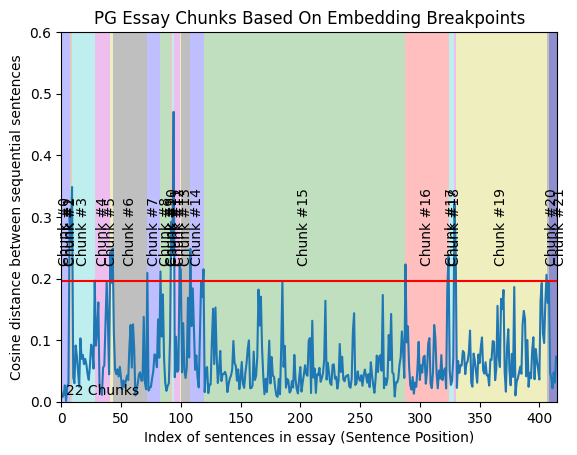

standard_deviation 1


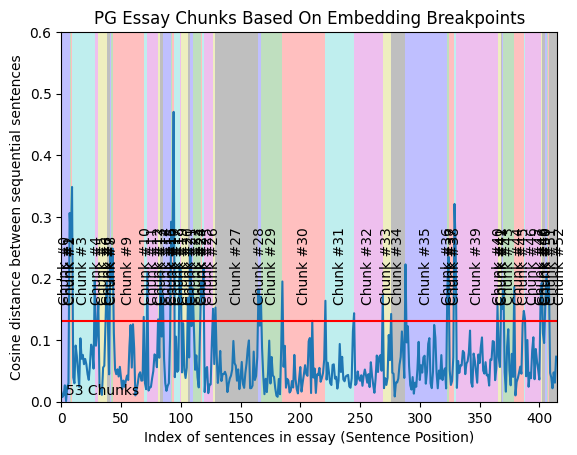

standard_deviation 2


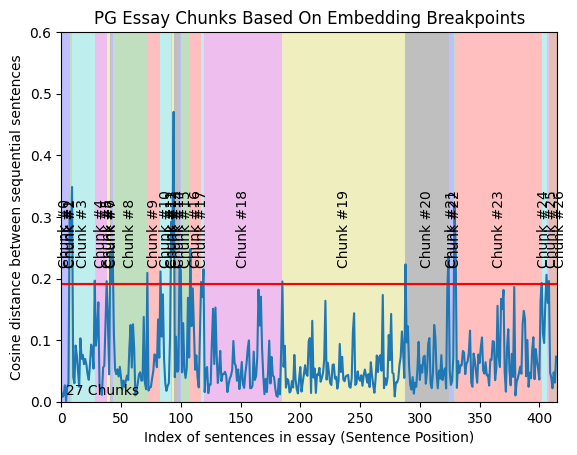

standard_deviation 3


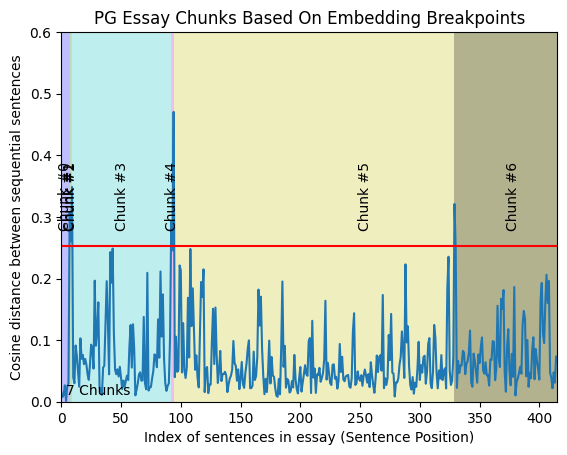

interquartile 1.5


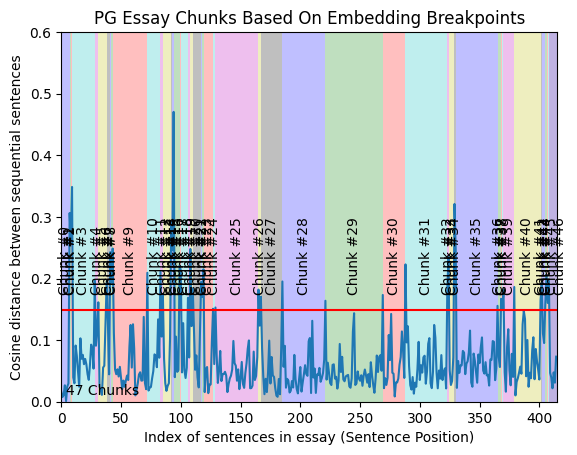

interquartile 1.6


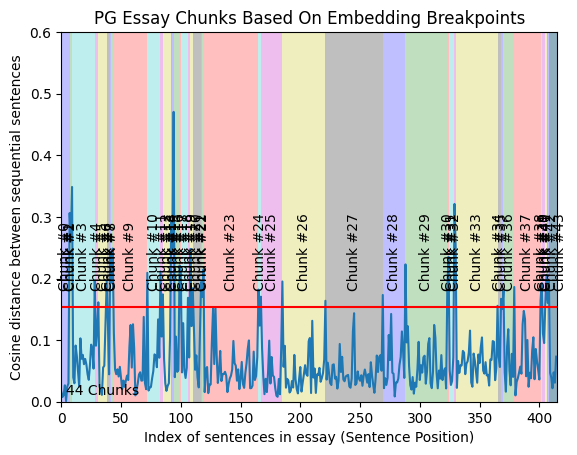

interquartile 1.7


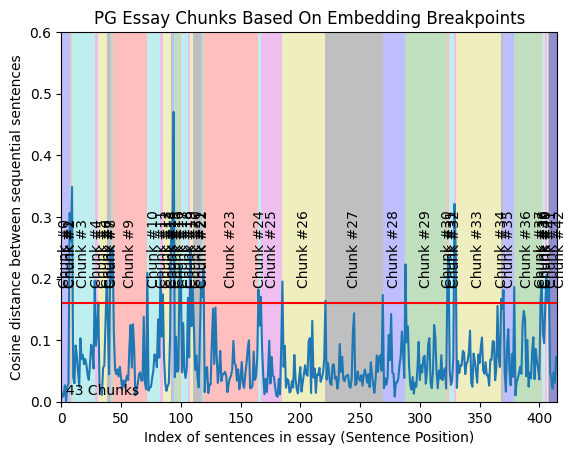

interquartile 1.8


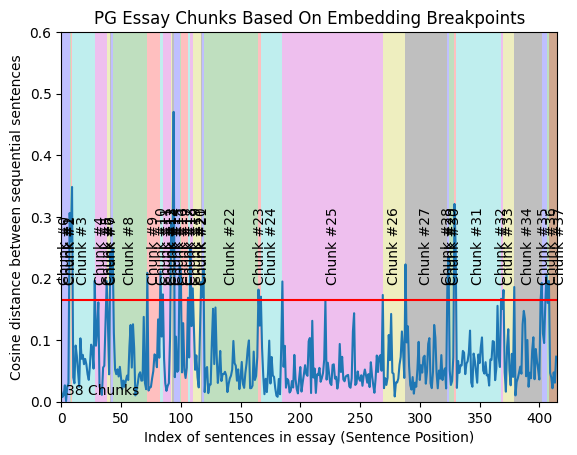

interquartile 1.4


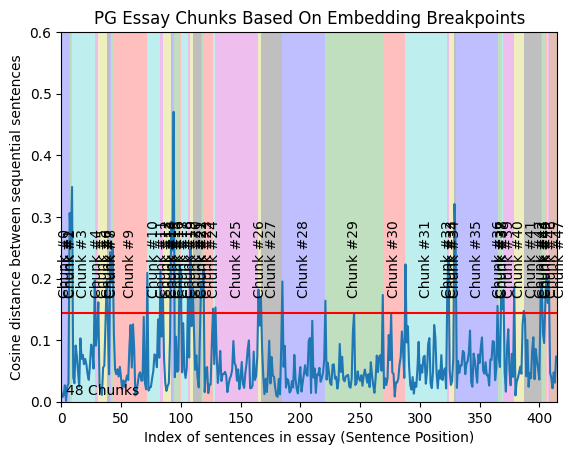

gradient 98


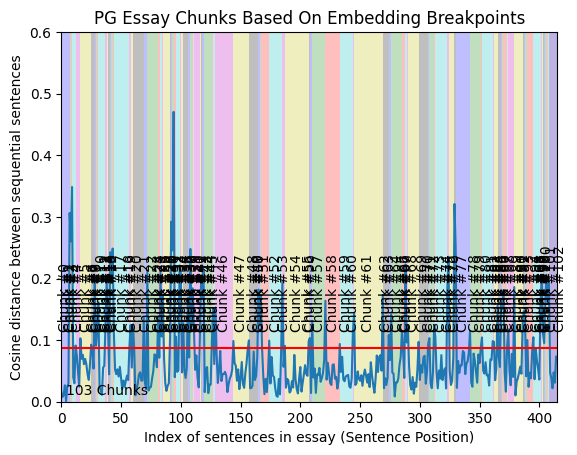

gradient 99


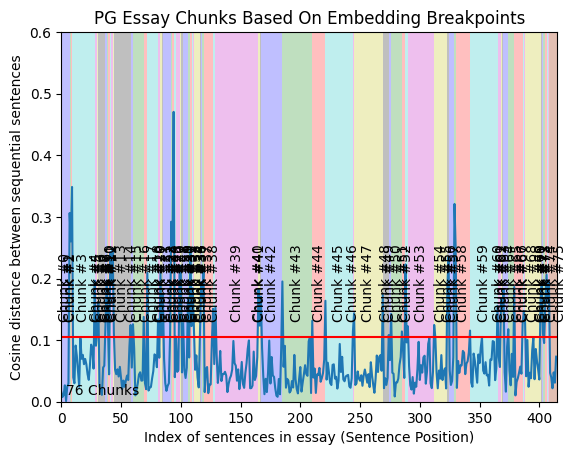

gradient 100


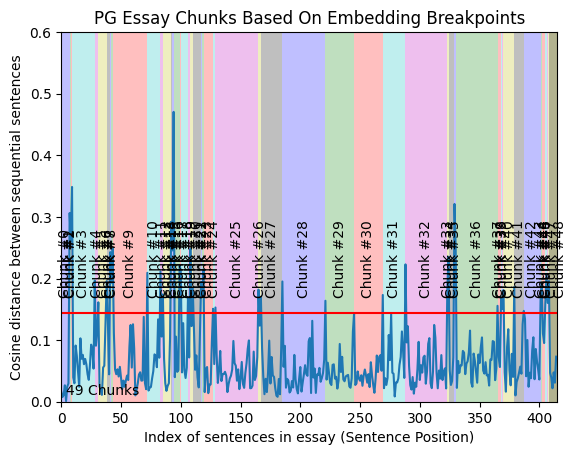

In [83]:
types = {"percentile": [95],"standard_deviation": [1,2,3], "interquartile":[1.5, 1.6, 1.7, 1.8, 1.4],"gradient":[98,  99, 100]}

text =book_structure['parts'][2]['chapters'][0]['content']
for t in types.keys():
    for v in types[t]:
        print(t, v)
        splitter = SemanticChunker(HuggingFaceEmbeddings(), breakpoint_threshold_type=t, breakpoint_threshold_amount=v, buffer_size=5)
        _ = splitter.split_text(text)
    # print("chunked len: ", len(" ".join(_).split()), "original len: ", len(text.split()))
# print(_[10])

c:\Python312\Lib\site-packages\huggingface_hub\file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


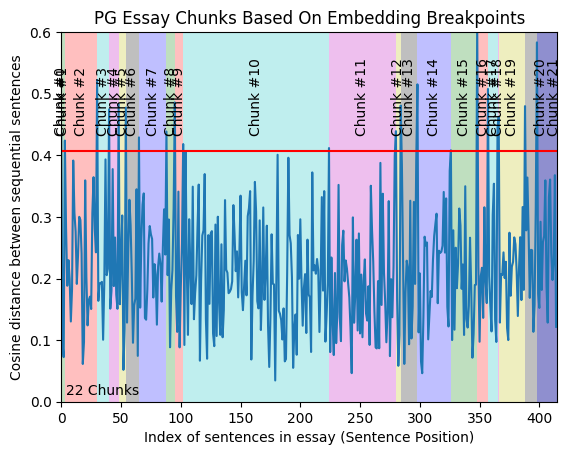

chunked len:  4554 original len:  4554
How could the man smile? The enemy army was blowing horns. Did that mean they were ready? Even though Cenn had just relieved himself, he felt a trickle of urine run down his leg. “Stay firm,” Kaladin said, then trotted down the front line to talk to the next squadleader over. Behind Cenn and the others, the dozens of ranks were still growing. The archers on the sides prepared to fire. “Don’t worry, son,” Dallet said. “We’ll be fine. Squadleader Kaladin is lucky.”
The soldier on the other side of Cenn nodded. He was a lanky, red-haired Veden, with darker tan skin than the Alethi. Why was he fighting in an Alethi army? “That’s right. Kaladin, he’s stormblessed, right sure he is. We only lost … what, one man last battle?”
“But someone did die,” Cenn said. Dallet shrugged. “People always die. Our squad loses the fewest. You’ll see.”
Kaladin finished conferring with the other squadleader, then jogged back to his team. Though he carried a shortspear—mea

In [35]:
text =book_structure['parts'][2]['chapters'][0]['content']
for b in [2,3,4]:
    splitter = SemanticChunker(HuggingFaceEmbeddings(), breakpoint_threshold_amount=95, buffer_size=b)
    _ = splitter.split_text(text)
    print("chunked len: ", len(" ".join(_).split()), "original len: ", len(text.split()))
print(_[10])

In [39]:
chunks[percent[2]]

IndexError: list index out of range

### Create chunks

In [49]:
splitter = SemanticChunker(HuggingFaceEmbeddings(), breakpoint_threshold_amount=95)

c:\Python312\Lib\site-packages\huggingface_hub\file_download.py:1150: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


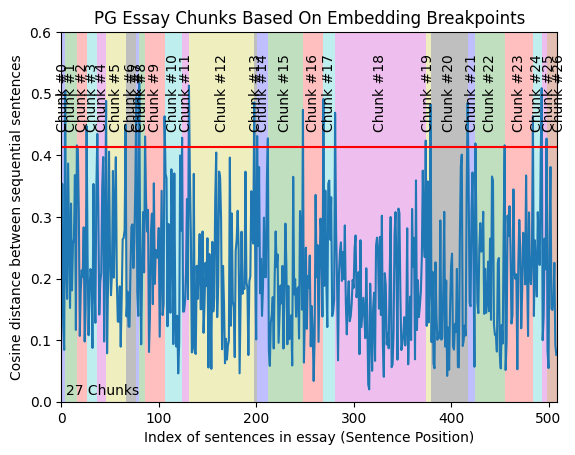

27


In [55]:
_ = splitter.split_text(book_structure['parts'][1]['content'])
print(len(_))

In [ ]:
splitter.split_text(book_structure['parts'[1]['con']])

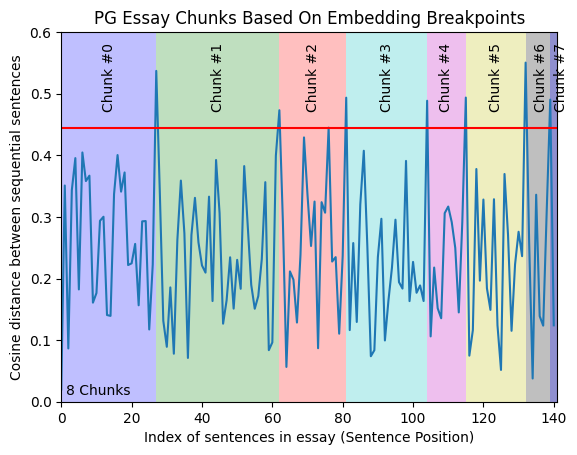

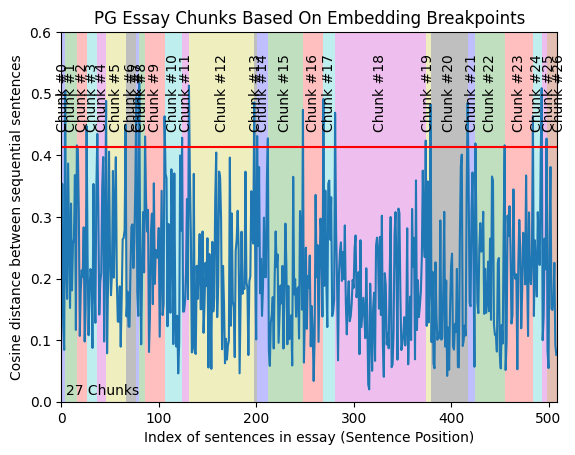

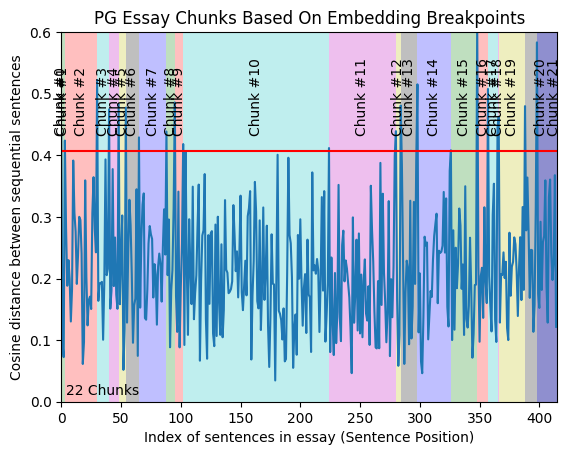

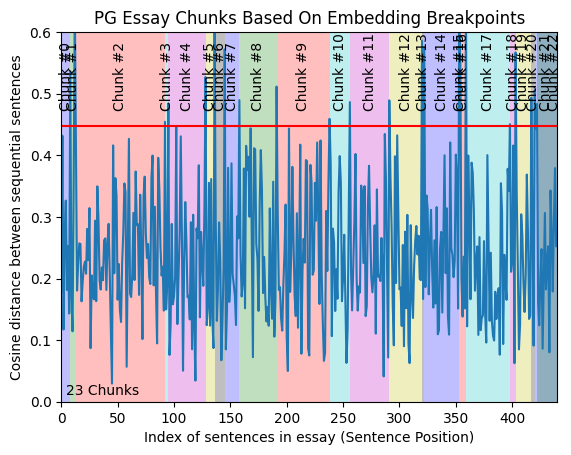

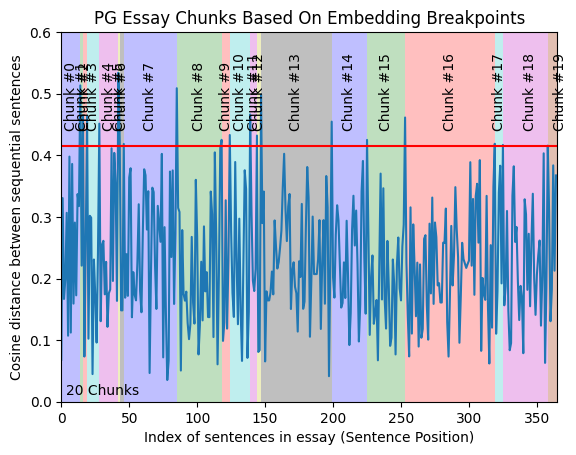

...

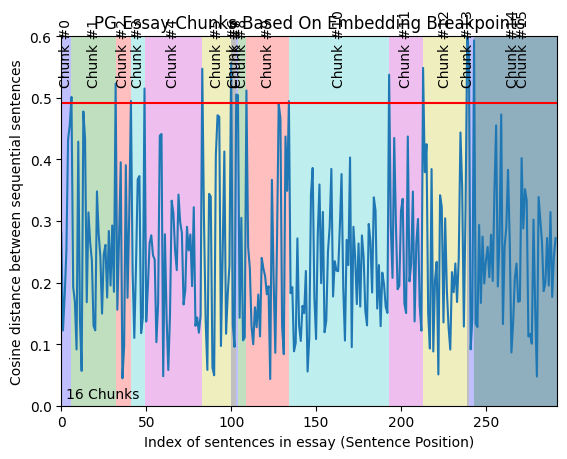

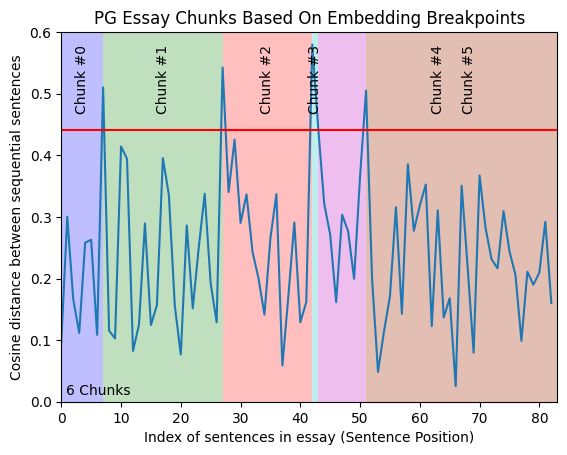

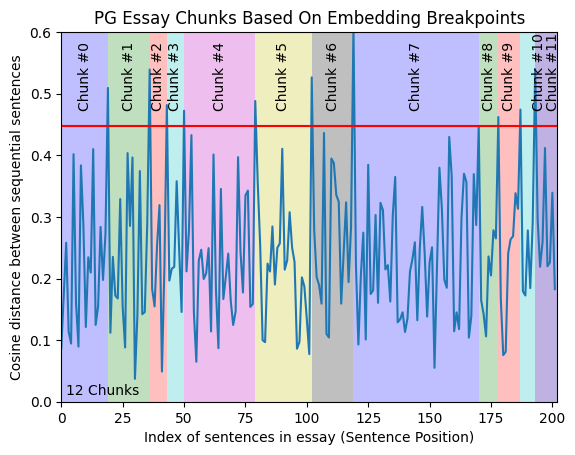

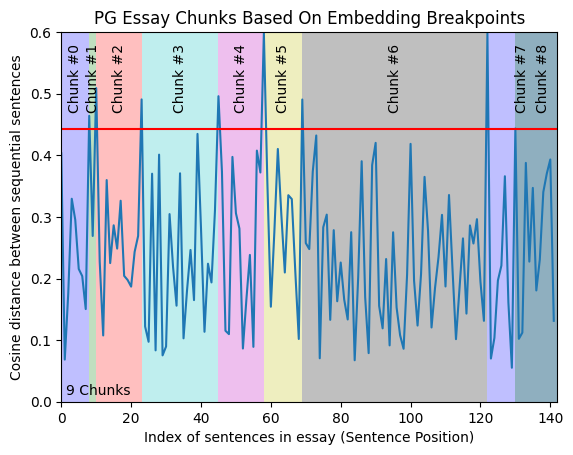

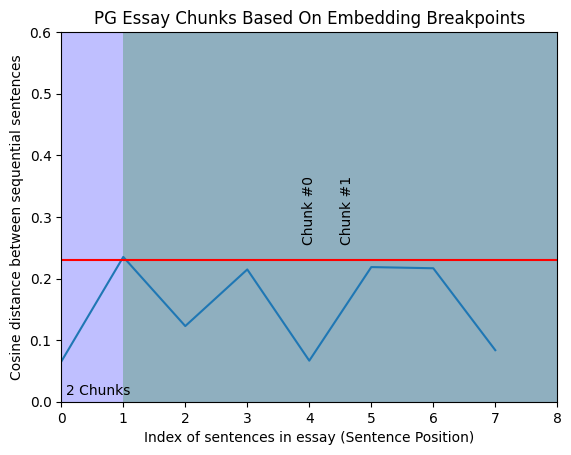

In [56]:
for part in book_structure['parts']:
    if 'content' in part.keys():
        part['chunks'] = splitter.split_text(part['content'])
    elif 'chapters' in part.keys():
        for chapter in part['chapters']:
            chapter['chunks'] = splitter.split_text(chapter['content'])
    elif 'interludes' in part.keys():
        for interlude in part['interludes']:
            for chapter in interlude['chapters']:
                chapter['chunks'] = splitter.split_text(chapter['content'])

In [61]:
print(book_structure['parts'][-2]['chunks'][4:6])

['Their answers speak for the souls of men. In our hearts, we want to believe in—and would choose—great accomplishment and virtue. That’s why our lies, particularly to ourselves, are so beautiful.”\nHe began to play a real song. A simple melody at first, soft, subdued. A song for a silent night when the entire world changed. One of the soldiers cleared his throat. “So what is the most valuable talent a man can have?” He sounded genuinely curious. “I haven’t the faintest idea,” Wit said. “Fortunately, that wasn’t the question. I didn’t ask what was most valuable, I asked what men value most. The difference between those questions is at once both tiny and as vast as the world itself.”\nHe kept plucking his song. One did not strum an enthir. It just wasn’t done, at least not by people with any sense of propriety.', '“In this,” Wit said, “as in all things, our actions give us away. If an artist creates a work of powerful beauty—using new and innovative techniques—she will be lauded as a ma

In [75]:
book_structure['parts'][2]

{'title': 'Part One: Above Silence',
 'chapters': [{'title': '1: STORMBLESSED',
   'content': '“You’ve killed me. Bastards, you’ve killed me! While the sun is still hot, I die!”\n—Collected on the fifth day of the week Chach of the month Betab of the year 1171, ten seconds before death. Subject was a darkeyed soldier thirty-one years of age. Sample is considered questionable.\n\xa0\nFIVE YEARS LATER\xa0\nI’m going to die, aren’t I?” Cenn asked.\nThe weathered veteran beside Cenn turned and inspected him. The veteran wore a full beard, cut short. At the sides, the black hairs were starting to give way to grey.\nI’m going to die, Cenn thought, clutching his spear—the shaft slick with sweat. I’m going to die. Oh, Stormfather. I’m going to die. …\n“How old are you, son?” the veteran asked. Cenn didn’t remember the man’s name. It was hard to recall anything while watching that other army form lines across the rocky battlefield. That lining up seemed so civil. Neat, organized. Shortspears in

In [42]:
data = []
for chunk in book_structure['parts'][1]['chunks']:
    data.append(len(chunk.split()))

print("Avg words per chunk", sum(data)/len(data))
print("Most words in a chunk", max(data))

Avg words per chunk 229.40740740740742
Most words in a chunk 1268


## Vectorizing

In [ ]:
from sys import path
path.append(r'C:\Users\Izogie\Desktop\Folders\Projects\Python\KB Chat\src')
from modules.utils import load_config
load_config()

from os import environ
from google.generativeai import GenerativeModel, configure
configure(api_key=environ["GOOGLE_API_KEY"])

### Chunk summaries

In [83]:
book_structure['parts'][2]

{'title': 'Part One: Above Silence',
 'chapters': [{'title': '1: STORMBLESSED',
   'content': '“You’ve killed me. Bastards, you’ve killed me! While the sun is still hot, I die!”\n—Collected on the fifth day of the week Chach of the month Betab of the year 1171, ten seconds before death. Subject was a darkeyed soldier thirty-one years of age. Sample is considered questionable.\n\xa0\nFIVE YEARS LATER\xa0\nI’m going to die, aren’t I?” Cenn asked.\nThe weathered veteran beside Cenn turned and inspected him. The veteran wore a full beard, cut short. At the sides, the black hairs were starting to give way to grey.\nI’m going to die, Cenn thought, clutching his spear—the shaft slick with sweat. I’m going to die. Oh, Stormfather. I’m going to die. …\n“How old are you, son?” the veteran asked. Cenn didn’t remember the man’s name. It was hard to recall anything while watching that other army form lines across the rocky battlefield. That lining up seemed so civil. Neat, organized. Shortspears in

In [112]:
from ratelimit import limits, RateLimitException, sleep_and_retry
from backoff import on_exception, expo
import google.api_core.exceptions as google_exceptions
from google.generativeai.types import HarmCategory, HarmBlockThreshold


MINUTE = 60
    # rate is 1 QPS.
@sleep_and_retry  # If there are more requests to this function than rate, sleep shortly
@on_exception(
    expo, google_exceptions.ResourceExhausted, max_tries=10  # if we receive exceptions from Google API, retry
)
@limits(calls=40, period=MINUTE)
def call_prompt_in_rate(prompt: str) -> str:
    """
    Calls the LLM model and applies rate limits.

    Args:
        prompt (str): The prompt.

    Returns:
        str: The generated content.
    """
    # return model.invoke(prompt) #Langchain openai
    return llm.generate_content(prompt,safety_settings={HarmCategory.HARM_CATEGORY_SEXUALLY_EXPLICIT: HarmBlockThreshold.BLOCK_NONE,
HarmCategory.HARM_CATEGORY_HATE_SPEECH: HarmBlockThreshold.BLOCK_NONE,
HarmCategory.HARM_CATEGORY_HARASSMENT: HarmBlockThreshold.BLOCK_NONE,
HarmCategory.HARM_CATEGORY_DANGEROUS_CONTENT: HarmBlockThreshold.BLOCK_NONE,})

In [129]:

llm = GenerativeModel(model_name="gemini-1.5-flash")
data = []
for i, part in enumerate(book_structure['parts'][:3]):
    # print(part)
    if 'chunks' in part.keys():
        # data.extend(part['chunks'])
        for j, chunk in enumerate(part['chunks']):
             prompt = f"""Summarize the following chunk of text from the book Way of Kings by Brandon Sanderson. If there is information that not discussed in the chunk, do not state that it is not discussed. The summary should be written as if you are aware of the context, but the summary should be concise and focused on the content of the chunk.
        chunk: {chunk}"""
             print(i, j)
             response = call_prompt_in_rate([prompt])
             summary = response.text
             book_structure['parts'][i]['chunks'][j] = {'summary': summary, 'chunk': chunk}
    elif 'chapters' in part.keys():
        for k, chapter in enumerate(part['chapters']):
            for l, chunk in enumerate(chapter['chunks']):
                print(i, k,l)
                prompt = f"""Summarize the following chunk of text from the book Way of Kings by Brandon Sanderson. If there is information that not discussed in the chunk, do not state that it is not discussed. The summary should be written as if you are aware of the context, but the summary should be concise and focused on the content of the chunk.
                chunk: {chunk}"""
                response = call_prompt_in_rate([prompt])
                summary = response.text
                book_structure['parts'][i]['chapters'][k]['chunks'][l] ={'summary': summary, 'chunk': chunk}
    elif 'interludes' in part.keys():
        for interlude in part['interludes']:
            for chapter in interlude['chapters']:
                chapter['chunks'] = splitter.split_text(chapter['content'])

0 0
0 1
0 2
0 3
0 4
0 5
0 6
0 7
1 0
1 1
1 2
1 3
1 4
1 5
1 6
1 7
1 8
1 9
1 10
1 11
1 12
1 13
1 14
1 15
1 16
1 17
1 18
1 19
1 20
1 21
1 22
1 23
1 24
1 25
1 26
2 0 0
2 0 1
2 0 2
2 0 3
2 0 4
2 0 5
2 0 6
2 0 7
2 0 8
2 0 9
2 0 10
2 0 11
2 0 12
2 0 13
2 0 14
2 0 15
2 0 16
2 0 17
2 0 18
2 0 19
2 0 20
2 0 21
2 1 0
2 1 1
2 1 2
2 1 3
2 1 4
2 1 5
2 1 6
2 1 7
2 1 8
2 1 9
2 1 10
2 1 11
2 1 12
2 1 13
2 1 14
2 1 15
2 1 16
2 1 17
2 1 18
2 1 19
2 1 20
2 1 21
2 1 22
2 2 0
2 2 1
2 2 2
2 2 3
2 2 4
2 2 5
2 2 6
2 2 7
2 2 8
2 2 9
2 2 10
2 2 11
2 2 12
2 2 13
2 2 14
2 2 15
2 2 16
2 2 17
2 2 18
2 2 19
2 3 0
2 3 1
2 3 2
2 3 3
2 3 4
2 3 5
2 3 6
2 3 7
2 3 8
2 3 9
2 3 10
2 3 11
2 3 12
2 3 13
2 3 14
2 3 15
2 3 16
2 3 17
2 3 18
2 4 0
2 4 1
2 4 2
2 4 3
2 4 4
2 4 5
2 4 6
2 4 7
2 4 8
2 4 9
2 4 10
2 4 11
2 4 12
2 4 13
2 4 14
2 4 15
2 4 16
2 5 0
2 5 1
2 5 2
2 5 3
2 5 4
2 5 5
2 5 6
2 5 7
2 5 8
2 5 9
2 5 10
2 5 11
2 5 12
2 5 13
2 5 14
2 5 15
2 5 16
2 5 17
2 5 18
2 5 19
2 5 20
2 5 21
2 5 22
2 5 23
2 5 24
2 5 25
2 5 26
2 5 27


In [100]:
response.text

"The statue of Shalash, one of the ten Highstorms, is missing from the King's palace, which is unusual given Gavilar's known devotion to the Vorin religion. \n"

In [130]:
book_structure['parts'][2]['chapters'][0]['chunks'][3]

{'summary': 'Cenn, a young man of 15, faces his first battle, terrified by the sheer number of enemy soldiers. He realizes he is a coward for leaving the safety of the herds and fears he will die. Veteran soldier Dallet reassures Cenn, telling him he will be alright. \n',
 'chunk': 'This was real. Facing that fact—his heart pounding like a frightened animal in his chest, his legs unsteady—Cenn suddenly realized that he was a coward. He shouldn’t have left the herds! He should never have—\n“Son?” the veteran said, voice firm. “How old are you?”\n“Fifteen, sir.”\n“And what’s your name?”\n“Cenn, sir.”\nThe mountainous, bearded man nodded. “I’m Dallet.”\n“Dallet,” Cenn repeated, still staring out at the other army. There were so many of them! Thousands. “I’m going to die, aren’t I?”\n“No.” Dallet had a gruff voice, but somehow that was comforting. “You’re going to be just fine.'}

In [133]:
from json import dump
with open('book_structure.txt', 'w') as f:
    f.write(str(book_structure))

In [47]:
book_structure

{'parts': [{'title': 'Prelude to the Stormlight Archive',
   'content': 'PRELUDE TOTHE STORMLIGHT ARCHIVE\xa0\nKalak rounded a rocky stone ridge and stumbled to a stop before the body of a dying thunderclast. The enormous stone beast lay on its side, riblike protrusions from its chest broken and cracked. The monstrosity was vaguely skeletal in shape, with unnaturally long limbs that sprouted from granite shoulders. The eyes were deep red spots on the arrowhead face, as if created by a fire burning deep within the stone. They faded.\nEven after all these centuries, seeing a thunderclast up close made Kalak shiver. The beast’s hand was as long as a man was tall. He’d been killed by hands like those before, and it hadn’t been pleasant.\nOf course, dying rarely was.\nHe rounded the creature, picking his way more carefully across the battlefield. The plain was a place of misshapen rock and stone, natural pillars rising around him, bodies littering the ground. Few plants lived here.\nThe sto

# Importing

## Only chunks

In [45]:
# from modules.SourceManager import SourceManager
# from modules.VectorDBManager import VectorDBManager
from pipeline import RAGPipeline

In [46]:
# source_manager = SourceManager()
# db_manager = VectorDBManager()
pipe = RAGPipeline()

c:\Python312\Lib\site-packages\posthog\client.py:345: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  timestamp = datetime.utcnow().replace(tzinfo=tzutc())
c:\Python312\Lib\site-packages\posthog\request.py:40: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  body["sentAt"] = datetime.utcnow().replace(tzinfo=tzutc()).isoformat()
c:\Python312\Lib\site-packages\posthog\client.py:345: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  timestamp = datetime.utcnow().replace(tzinfo=tzutc())


c:\Python312\Lib\site-packages\posthog\request.py:40: DeprecationWarning: datetime.datetime.utcnow() is deprecated and scheduled for removal in a future version. Use timezone-aware objects to represent datetimes in UTC: datetime.datetime.now(datetime.UTC).
  body["sentAt"] = datetime.utcnow().replace(tzinfo=tzutc()).isoformat()


In [ ]:
data = []
book = "Way of Kings"
for p, part in enumerate(book_structure['parts']):
    if 'chunks' in part.keys():
        for c, chunk in enumerate(part['chunks']):
            metadata = {
                "source": "prose",
                "book": book,
                "part": p,
                "title": part['title'],
                "child_type": "part"
                "chunk_num": c
                }
            data.append({'content': chunk, "metadata": metadata})   
    elif 'chapters' in part.keys():
        for h, chapter in enumerate(part['chapters']):
            for c, chunk in enumerate(chapter['chunks']):
                metadata = {
                    "source": "prose",
                    "book": book,
                    "part": p,
                    "title": chapter['title'],
                    "child_type": "chapter"
                    "chapter": h,
                    "chunk_num": c
                    }
                data.append({'content': chunk, "metadata": metadata})
                
    elif 'interludes' in part.keys():
        for interlude in part['interludes']:
            for h, chapter in enumerate(interlude['chapters']):
                for c, chunk in enumerate(chapter['chunks']):
                    metadata = {
                        "source": "prose",
                        "book": book,
                        "part": p,
                        "title": chapter['title'],
                        "child_type": "interlude"
                        "chapter": h,
                        "chunk_num": c
                        }
                    data.append({'content': chunk, "metadata": metadata})
                
docs = pipe.source_manager.to_documents(data)


In [ ]:
pipe.vector_manager.